# Mapping Brooklyn Borough to visualize the areas of interest to find out the food desert

### As per the USDA, an area can be classified as food desert if it meets the following two conditions:
    
1. Poverty Rate is greater than or equal to 20% or a household with income less than the federal poverty level of USD 17,050 for a family of four in 2000

2. At least 500 people or 33% of the population is located more than 1 mile (Urban) and 10 miles (Rural) from the nearest supermarket or grocery store

## Insights found during Visualization

After visualizing the <b>Food Access Research Atlas 2019</b> using GIS tool of Geopandas, it was found that in Brooklyn, there are multiple census tracts having greater than or equal to 20% poverty rate which meets condition one but not a single tract meets condition 2 which technically suggests that <b>Brooklyn do not have any Food Desert</b> as per the official definition given by US Department of Agriculture (USDA).

However, Based on multiple articles published by community bloggers, it is found that Central Brooklyn is one of two worst food desert with neighborhoods such as <b>Ocean Hill, Brownsville, and Bedford-Stuyvesant</b> being the lowest income members.

Few such sources are: 
1. https://neighborstogether.org/our-community/
2. https://www.thecity.nyc/2022/07/14/eric-adams-food-apartheid-bed-stuy-residents-affordable-grocery/
3. https://www.cbsnews.com/newyork/news/food-insecurity-remains-big-problem-in-more-than-2-dozen-neighborhoods-in-new-york-city/


The following codes will take a look into variables from different sources and map them over the borough of Brooklyn

#### Sources used are:

1. New York State Map : <b>Uploaded on Github under Data Collection folder as cb_2019_36_tract_500k.shx.</b>
2. Food Access Research Atlas 2019 : <b>Uploaded on Github under Data Collection folder as Kings_data.csv</b>

3. Grocery Store Database 2017: <b>https://nanda.isr.umich.edu/project/grocery-stores/</b>
4. Socio-Economic Database 2016 <b>https://nanda.isr.umich.edu/project/socioeconomic-status-and-demographic-characteristics/</b>
5. Eating & Drinking Database 2017:<b>https://nanda.isr.umich.edu/project/eating-and-drinking-places/</b>
6. Convenience Stores 2017:<b>https://nanda.isr.umich.edu/project/liquor-tobacco-and-convenience-stores/</b>

In [1]:
### Importing GIS Libraries
import geopandas as gpd
import plotly.graph_objects as go

### Importing data preprocessing & visualization libraries
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

### Importing warning library
import warnings
warnings.filterwarnings("ignore")

## Database 1: New York State Map

In [2]:
### Storing New York Map coordinates of 2019 as a pandas dataframe
ny_map = gpd.read_file(r'C:\Users\tuhin\OneDrive\Desktop\Omdena Brooklyn\cb_2019_36_tract_500k.shp', encoding='utf-8')

In [3]:
### Checking how the dataframe looks like
ny_map.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,36,071,000502,1400000US36071000502,36071000502,5.02,CT,967431,969216,"POLYGON ((-74.02226 41.49281, -74.02180 41.496..."
1,36,103,135208,1400000US36103135208,36103135208,1352.08,CT,2287077,0,"POLYGON ((-73.28263 40.83063, -73.28157 40.832..."


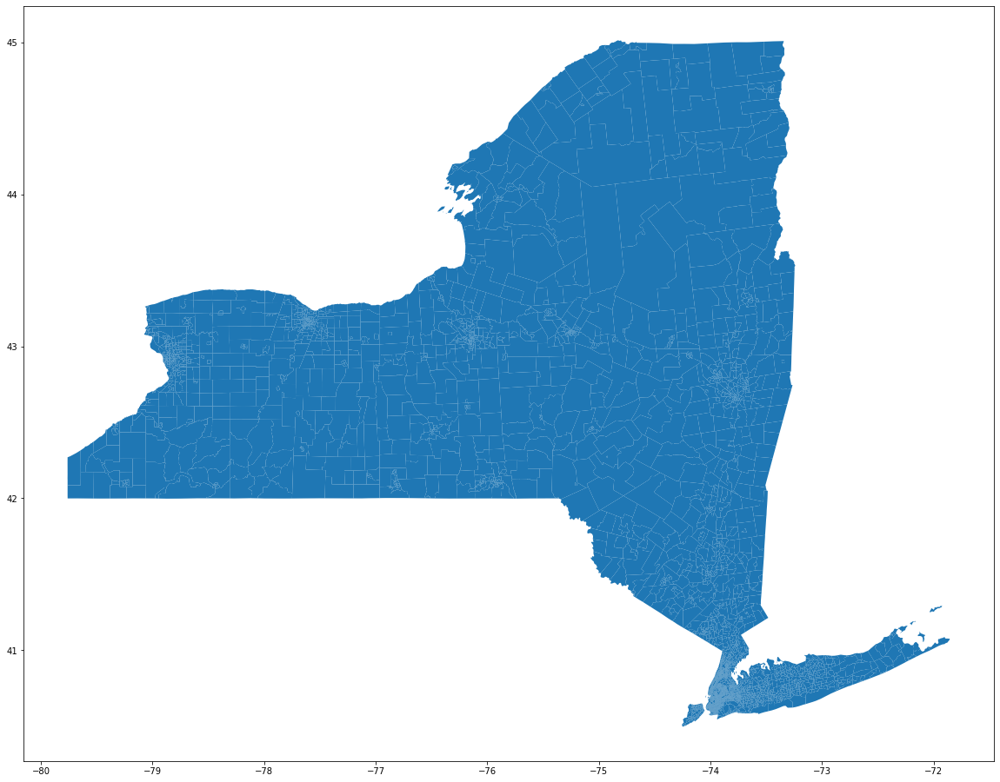

In [4]:
### Plotting the map of New York state

fig, ax = plt.subplots(figsize=(20,20))
ny_map.plot(ax=ax)
plt.show()

In [5]:
### Checking if all New York Counties are present in the dataframe

print("The total number of counties present in New York is", ny_map['COUNTYFP'].nunique())

print("Showing all county codes")
ny_map["COUNTYFP"].unique()

The total number of counties present in New York is 62
Showing all county codes


array(['071', '103', '047', '055', '005', '029', '061', '119', '033',
       '001', '085', '069', '067', '081', '007', '107', '051', '059',
       '073', '015', '063', '053', '065', '083', '027', '117', '009',
       '057', '037', '093', '021', '087', '121', '111', '105', '043',
       '019', '109', '023', '011', '113', '091', '035', '013', '099',
       '075', '039', '089', '045', '101', '095', '003', '025', '049',
       '097', '115', '017', '031', '077', '079', '123', '041'],
      dtype=object)

In [6]:
## Select "Kings County" which is code - 047 (Brooklyn Borough)

kings_map = ny_map[ny_map["COUNTYFP"]=="047"]

In [7]:
## Checking the column headers of kings dataframe
kings_map.head(5)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
2,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601..."
3,36,047,058900,1400000US36047058900,36047058900,589,CT,424025,38353,"POLYGON ((-73.94605 40.72926, -73.94419 40.729..."
18,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588..."
19,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686..."
26,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598..."


## Database 2: Food Access Research Atlas 2019 - Kings County

In [8]:
### Reading the Food Access Research Atlas of 2019

kings_foodaccess = pd.read_csv('kings_data.csv')
kings_foodaccess.head(2)

,CensusTract,Track Code,State,County,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,...,TractSeniors,TractWhite,TractBlack,TractAsian,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP
0,36047000100,100,New York,Kings County,1,4338,2227,0,424,9.77,...,843,3396,427,330,0,15,170,347,1417,126
1,36047000200,200,New York,Kings County,1,1470,360,0,39,2.65,...,70,530,103,49,0,16,772,1277,265,138


In [9]:
### Imputing leading zeroes which usually gets removed when reading a csv file
kings_foodaccess['Track Code'] = kings_foodaccess['Track Code'].astype(str)
kings_foodaccess['Track Code'] = kings_foodaccess['Track Code'].str.zfill(6)

In [10]:
kings_foodaccess.head(2)

,CensusTract,Track Code,State,County,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,...,TractSeniors,TractWhite,TractBlack,TractAsian,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP
0,36047000100,000100,New York,Kings County,1,4338,2227,0,424,9.77,...,843,3396,427,330,0,15,170,347,1417,126
1,36047000200,000200,New York,Kings County,1,1470,360,0,39,2.65,...,70,530,103,49,0,16,772,1277,265,138


In [11]:
### TRACTCE will be the primary key to link all the database.
## Renaming Tract Code as "TRACTCE"

kings_foodaccess = kings_foodaccess.rename(columns={'Track Code': 'TRACTCE'})
kings_foodaccess.head(2)

,CensusTract,TRACTCE,State,County,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,...,TractSeniors,TractWhite,TractBlack,TractAsian,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP
0,36047000100,000100,New York,Kings County,1,4338,2227,0,424,9.77,...,843,3396,427,330,0,15,170,347,1417,126
1,36047000200,000200,New York,Kings County,1,1470,360,0,39,2.65,...,70,530,103,49,0,16,772,1277,265,138


In [12]:
### We need to map TRACTCE in kings database and TRACTCE in Food Atlas 2019 database to create a single database

first_compiled = kings_map.merge(kings_foodaccess, on='TRACTCE')

In [13]:
### Checking the total number of census tracks present in Kings County (Brooklyn Borough)

first_compiled['TRACTCE'].nunique()

754

In [14]:
### Visualizing the Brooklyn Borough with Poverty Rate as one of the key metric

fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=first_compiled.geometry.__geo_interface__,
                                   locations=first_compiled.index,
                                   z=first_compiled['PovertyRate'],
                                   colorscale='OrRd',
                                   zmin=first_compiled['PovertyRate'].min(),
                                   zmax=first_compiled['PovertyRate'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover option Over Text
hover_text = []
for idx, row in first_compiled.iterrows():
    hover_text.append(f"Census Tract Area: {row['TRACTCE']}<br>PovertyRate: {row['PovertyRate']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": first_compiled.geometry.centroid.y.mean(), 
                                 "lon": first_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='Poverty Rate')
fig.show()

## Visualizing Low Income and Low Access Census Tracts which are 1/2 mile from nearest supermarket

In [15]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=first_compiled.geometry.__geo_interface__,
                                   locations=first_compiled.index,
                                   z=first_compiled['LILATracts_halfAnd10'],
                                   colorscale='OrRd',
                                   zmin=first_compiled['LILATracts_halfAnd10'].min(),
                                   zmax=first_compiled['LILATracts_halfAnd10'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in first_compiled.iterrows():
    hover_text.append(f"Census Tract Area: {row['TRACTCE']}<br>Low Income & Low Access - 1/2 mile: {row['PovertyRate']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": first_compiled.geometry.centroid.y.mean(), "lon": first_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='LILATracts_halfAnd10')
fig.show()


## Database 3: Grocery Store 2003 - 2017

This database contains the following
1. 445110: supermarkets and grocery stores, excluding convenience stores.
2. 4452: all specialty food stores. These include meat, fish, and seafood markets, produce markets, baked goods stores, and spice stores.
3. 452311: warehouse clubs and supercenters, which sell fresh food alongside canned and packaged foods and other types of merchandise (such as clothing and furniture).


<b><i>2017 Grocery data was used as a proxy to 2019 Food Access Research Atlas data</i></b>

In [16]:
grocery_data = pd.read_csv('Grocery store database.csv')
grocery_data.head(2)

,tract_fips10,year,population,aland10,count_445110,count_sales_445110,count_emp_445110,popden_445110,popden_sales_445110,popden_emp_445110,...,aden_emp_4452,count_452311,count_sales_452311,count_emp_452311,popden_452311,popden_sales_452311,popden_emp_452311,aden_452311,aden_sales_452311,aden_emp_452311
0,1001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,1001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
grocery_data['tract_fips10'] = grocery_data['tract_fips10'].astype(str)
grocery_data['tract_fips10'] = grocery_data['tract_fips10'].str.zfill(11)

In [18]:
grocery_data.head(2)

,tract_fips10,year,population,aland10,count_445110,count_sales_445110,count_emp_445110,popden_445110,popden_sales_445110,popden_emp_445110,...,aden_emp_4452,count_452311,count_sales_452311,count_emp_452311,popden_452311,popden_sales_452311,popden_emp_452311,aden_452311,aden_sales_452311,aden_emp_452311
0,01001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,01001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [19]:
# Extracting portions
grocery_data['State_Code'] = grocery_data['tract_fips10'].str[:2]
grocery_data['County_Code'] = grocery_data['tract_fips10'].str[2:5]
grocery_data['Census_Tract_Code'] = grocery_data['tract_fips10'].str[-6:]

In [20]:
grocery_data.head(2)

,tract_fips10,year,population,aland10,count_445110,count_sales_445110,count_emp_445110,popden_445110,popden_sales_445110,popden_emp_445110,...,count_emp_452311,popden_452311,popden_sales_452311,popden_emp_452311,aden_452311,aden_sales_452311,aden_emp_452311,State_Code,County_Code,Census_Tract_Code
0,01001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0,0.0,0.0,0.0,0.0,0.0,0.0,01,001,020100
1,01001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0,0.0,0.0,0.0,0.0,0.0,0.0,01,001,020100


In [21]:
### Selecting New York State (State Code = 36)
grocery_ny = grocery_data[grocery_data["State_Code"]=="36"]

In [22]:
### Selecting Kings County (county code = 047)
grocery_kings = grocery_ny[grocery_ny['County_Code'] == '047']

In [23]:
grocery_kings

,tract_fips10,year,population,aland10,count_445110,count_sales_445110,count_emp_445110,popden_445110,popden_sales_445110,popden_emp_445110,...,count_emp_452311,popden_452311,popden_sales_452311,popden_emp_452311,aden_452311,aden_sales_452311,aden_emp_452311,State_Code,County_Code,Census_Tract_Code
620074,36047000100,2003,5254.272,0.08627,4,4,4,0.761285,0.761285,0.761285,...,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,000100
620075,36047000100,2004,5164.090,0.08627,4,4,4,0.774580,0.774580,0.774580,...,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,000100
620076,36047000100,2005,5073.908,0.08627,3,3,3,0.591260,0.591260,0.591260,...,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,000100
620077,36047000100,2006,4983.727,0.08627,3,2,3,0.601959,0.401306,0.601959,...,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,000100
620078,36047000100,2007,4893.545,0.08627,4,3,4,0.817403,0.613053,0.817403,...,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,000100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
630723,36047990100,2012,0.000,0.00000,0,0,0,NaN,NaN,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,36,047,990100
630724,36047990100,2013,0.000,0.00000,0,0,0,NaN,NaN,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,36,047,990100
630725,36047990100,2014,0.000,0.00000,0,0,0,NaN,NaN,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,36,047,990100
630726,36047990100,2015,0.000,0.00000,0,0,0,NaN,NaN,NaN,...,0,NaN,NaN,NaN,NaN,NaN,NaN,36,047,990100


In [24]:
### TRACTCE will be the primary key to link all the database.
## Renaming Census Tract Code as "TRACTCE"

grocery_kings = grocery_kings.rename(columns={'Census_Tract_Code': 'TRACTCE'})

In [25]:
### Selecting only 2017 data

grocery_kings_17 = grocery_kings[grocery_kings['year'] == 2017]

In [26]:
grocery_kings_17['TRACTCE'].nunique()

761

In [27]:
### We need to map TRACTCE in first_compiled and TRACTCE in grocery database to create a single database

second_compiled = first_compiled.merge(grocery_kings_17, on='TRACTCE')

In [28]:
second_compiled.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,count_sales_452311,count_emp_452311,popden_452311,popden_sales_452311,popden_emp_452311,aden_452311,aden_sales_452311,aden_emp_452311,State_Code,County_Code
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047
1,36,047,058900,1400000US36047058900,36047058900,589,CT,424025,38353,"POLYGON ((-73.94605 40.72926, -73.94419 40.729...",...,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047


In [29]:
second_compiled.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 754 entries, 0 to 753
Columns: 190 entries, STATEFP to County_Code
dtypes: float64(133), geometry(1), int64(44), object(12)
memory usage: 1.1+ MB


## Database 4: Socio-Economic Data

In [30]:
socio = pd.read_csv('socio_eco_data.csv')
socio.head(2)

,TRACT_FIPS20,ALAND20,TOTPOP20,POPDEN16_20,PHISPANIC16_20,PNHWHITE16_20,PNHBLACK16_20,PFBORN16_20,PLIMENG16_20,PED1_16_20,...,POWNOC16_20,AFFLUENCE16_20,DISADVANTAGE16_20,HISPAN_FORBORN_LIMENG16_20,MEDFAMINC16_20,MEDFAMINC_NHWHITE16_20,MEDFAMINC_BLACK16_20,MEDFAMINC_HISPANIC16_20,RATIO_MEDFAMINC_NHWTOB16_20,RATIO_MEDFAMINC_NHWTOHISP16_20
0,1001020100,3.793571,1941,511.6551209,0.017001545,0.774858296,0.121071614,0.002060793,0,0.142857149,...,0.731601715,0.256776839,0.171104908,0.006354113,70699,71324,75104,,0.949669778,
1,1001020200,1.282175,1757,1370.327881,0.017074559,0.364826411,0.583949924,0.00284576,0,0.105864435,...,0.684118688,0.224515289,0.208804905,0.006640106,50133,83750,47604,,1.759305954,


In [31]:
socio['TRACT_FIPS20'] = socio['TRACT_FIPS20'].astype(str)
socio['TRACT_FIPS20'] = socio['TRACT_FIPS20'].str.zfill(11)

In [32]:
socio.head(2)

,TRACT_FIPS20,ALAND20,TOTPOP20,POPDEN16_20,PHISPANIC16_20,PNHWHITE16_20,PNHBLACK16_20,PFBORN16_20,PLIMENG16_20,PED1_16_20,...,POWNOC16_20,AFFLUENCE16_20,DISADVANTAGE16_20,HISPAN_FORBORN_LIMENG16_20,MEDFAMINC16_20,MEDFAMINC_NHWHITE16_20,MEDFAMINC_BLACK16_20,MEDFAMINC_HISPANIC16_20,RATIO_MEDFAMINC_NHWTOB16_20,RATIO_MEDFAMINC_NHWTOHISP16_20
0,01001020100,3.793571,1941,511.6551209,0.017001545,0.774858296,0.121071614,0.002060793,0,0.142857149,...,0.731601715,0.256776839,0.171104908,0.006354113,70699,71324,75104,,0.949669778,
1,01001020200,1.282175,1757,1370.327881,0.017074559,0.364826411,0.583949924,0.00284576,0,0.105864435,...,0.684118688,0.224515289,0.208804905,0.006640106,50133,83750,47604,,1.759305954,


In [33]:
# Extracting portions
socio['State_Code'] = socio['TRACT_FIPS20'].str[:2]
socio['County_Code'] = socio['TRACT_FIPS20'].str[2:5]
socio['Census_Tract_Code'] = socio['TRACT_FIPS20'].str[-6:]

In [34]:
socio.head(2)

,TRACT_FIPS20,ALAND20,TOTPOP20,POPDEN16_20,PHISPANIC16_20,PNHWHITE16_20,PNHBLACK16_20,PFBORN16_20,PLIMENG16_20,PED1_16_20,...,HISPAN_FORBORN_LIMENG16_20,MEDFAMINC16_20,MEDFAMINC_NHWHITE16_20,MEDFAMINC_BLACK16_20,MEDFAMINC_HISPANIC16_20,RATIO_MEDFAMINC_NHWTOB16_20,RATIO_MEDFAMINC_NHWTOHISP16_20,State_Code,County_Code,Census_Tract_Code
0,01001020100,3.793571,1941,511.6551209,0.017001545,0.774858296,0.121071614,0.002060793,0,0.142857149,...,0.006354113,70699,71324,75104,,0.949669778,,01,001,020100
1,01001020200,1.282175,1757,1370.327881,0.017074559,0.364826411,0.583949924,0.00284576,0,0.105864435,...,0.006640106,50133,83750,47604,,1.759305954,,01,001,020200


In [35]:
### Selecting New York State (State Code = 36)
socio_ny = socio[socio["State_Code"]=="36"]

In [36]:
### Selecting Kings County (county code = 047)
socio_kings = socio_ny[socio_ny['County_Code'] == '047']

In [37]:
socio_kings.head(2)

,TRACT_FIPS20,ALAND20,TOTPOP20,POPDEN16_20,PHISPANIC16_20,PNHWHITE16_20,PNHBLACK16_20,PFBORN16_20,PLIMENG16_20,PED1_16_20,...,HISPAN_FORBORN_LIMENG16_20,MEDFAMINC16_20,MEDFAMINC_NHWHITE16_20,MEDFAMINC_BLACK16_20,MEDFAMINC_HISPANIC16_20,RATIO_MEDFAMINC_NHWTOB16_20,RATIO_MEDFAMINC_NHWTOHISP16_20,State_Code,County_Code,Census_Tract_Code
50941,36047000100,0.080239,4539,56568.24609,0.069839172,0.645296335,0.146948665,0.124476761,0.022790698,0.003593145,...,0.072368875,195292,228307,,,,,36,047,000100
50942,36047000200,0.106923,992,9277.713867,0.73286289,0.164314523,0.021169355,0.353830636,0.273565561,0.37416777,...,0.453419685,,,,,,,36,047,000200


In [38]:
socio_kings = socio_kings.rename(columns={'Census_Tract_Code': 'TRACTCE'})

In [39]:
socio_kings.head(1)

,TRACT_FIPS20,ALAND20,TOTPOP20,POPDEN16_20,PHISPANIC16_20,PNHWHITE16_20,PNHBLACK16_20,PFBORN16_20,PLIMENG16_20,PED1_16_20,...,HISPAN_FORBORN_LIMENG16_20,MEDFAMINC16_20,MEDFAMINC_NHWHITE16_20,MEDFAMINC_BLACK16_20,MEDFAMINC_HISPANIC16_20,RATIO_MEDFAMINC_NHWTOB16_20,RATIO_MEDFAMINC_NHWTOHISP16_20,State_Code,County_Code,TRACTCE
50941,36047000100,0.080239,4539,56568.24609,0.069839172,0.645296335,0.146948665,0.124476761,0.022790698,0.003593145,...,0.072368875,195292,228307,,,,,36,047,000100


In [40]:
socio_kings['TRACTCE'].nunique()

805

In [41]:
third_compiled = pd.merge(second_compiled, socio_kings, on='TRACTCE', how='left')


In [42]:
third_compiled.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 754 entries, 0 to 753
Columns: 231 entries, STATEFP to County_Code_y
dtypes: float64(135), geometry(1), int64(44), object(51)
memory usage: 1.3+ MB


## Database 5: Eating & Drinking Data

This database contains the following
1. 7225: all restaurants and eating places.
2. 722511: full-service restaurants where patrons order and are served while seated.
3. 722513: limited service restaurants, e.g. fast-food restaurants.
4. 722515: snack and nonalcoholic beverage bars, such as coffee shops, doughnut or bagel shops, and ice cream parlors.
5. 722410: drinking places (alcoholic beverages), such as bars, taverns, and cocktail lounges.

<b><i>2017 Eating & Drinking Data is used as a proxy to 2019 Food Access Research Atlas data</i></b>

In [43]:
eating = pd.read_csv('eating.csv')
eating.head(2)

,tract_fips10,year,population,aland10,count_7225,count_sales_7225,count_emp_7225,popden_7225,popden_sales_7225,popden_emp_7225,...,aden_emp_722515,count_722410,count_sales_722410,count_emp_722410,popden_722410,popden_sales_722410,popden_emp_722410,aden_722410,aden_sales_722410,aden_emp_722410
0,1001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,1001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [44]:
eating['tract_fips10'] = eating['tract_fips10'].astype(str)
eating['tract_fips10'] = eating['tract_fips10'].str.zfill(11)

In [45]:
eating.head(2)

,tract_fips10,year,population,aland10,count_7225,count_sales_7225,count_emp_7225,popden_7225,popden_sales_7225,popden_emp_7225,...,aden_emp_722515,count_722410,count_sales_722410,count_emp_722410,popden_722410,popden_sales_722410,popden_emp_722410,aden_722410,aden_sales_722410,aden_emp_722410
0,01001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,01001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [46]:
# Extracting portions
eating['State_Code'] = eating['tract_fips10'].str[:2]
eating['County_Code'] = eating['tract_fips10'].str[2:5]
eating['TRACTCE'] = eating['tract_fips10'].str[-6:]

In [47]:
### Selecting New York State (State Code = 36)
eating_ny = eating[eating["State_Code"]=="36"]

In [48]:
### Selecting Kings County (county code = 047)
eating_kings = eating_ny[eating_ny['County_Code'] == '047']

In [49]:
eating_kings_17 = eating_kings[eating_kings['year'] == 2017]

In [50]:
fourth_compiled = pd.merge(third_compiled, eating_kings_17, on='TRACTCE', how='left')

In [51]:
fourth_compiled.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 754 entries, 0 to 753
Columns: 282 entries, STATEFP to County_Code
dtypes: float64(167), geometry(1), int64(60), object(54)
memory usage: 1.6+ MB


## Database 6: Convenience Stores. Liqour and Tobacco stores


This database contains the following
1. 4453: beer, wine, and liquor stores (also known as package stores).
2. 453991: cigar, cigarette, and tobacco stores, excluding stores that sell electronic cigarettes.
3. 445120: convenience stores without gas stations. These are defined by NAICS as “establishments…primarily engaged in retailing a limited line of goods that generally includes milk, bread, soda, and snacks.”
4.  447110: gas stations with convenience stores

<b><i>2017 Convenience stores, Liqour and Tobacco database is used as a proxy to 2019 Food Access Research Atlas data</i></b>

In [52]:
convenience = pd.read_csv('liquor_convenience_stores.csv')
convenience.head(2)

,tract_fips10,year,population,aland10,count_4453,count_sales_4453,count_emp_4453,popden_4453,popden_sales_4453,popden_emp_4453,...,aden_emp_445120,count_447110,count_sales_447110,count_emp_447110,popden_447110,popden_sales_447110,popden_emp_447110,aden_447110,aden_sales_447110,aden_emp_447110
0,1001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,1001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [53]:
convenience['tract_fips10'] = convenience['tract_fips10'].astype(str)
convenience['tract_fips10'] = convenience['tract_fips10'].str.zfill(11)

In [54]:
convenience.head(2)

,tract_fips10,year,population,aland10,count_4453,count_sales_4453,count_emp_4453,popden_4453,popden_sales_4453,popden_emp_4453,...,aden_emp_445120,count_447110,count_sales_447110,count_emp_447110,popden_447110,popden_sales_447110,popden_emp_447110,aden_447110,aden_sales_447110,aden_emp_447110
0,01001020100,2003,1858.883,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,01001020100,2004,1852.185,3.787641,0,0,0,0.0,0.0,0.0,...,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [55]:
# Extracting portions
convenience['State_Code'] = convenience['tract_fips10'].str[:2]
convenience['County_Code'] = convenience['tract_fips10'].str[2:5]
convenience['TRACTCE'] = convenience['tract_fips10'].str[-6:]

In [56]:
### Selecting New York State (State Code = 36)
convenience_ny = convenience[convenience["State_Code"]=="36"]

In [57]:
### Selecting Kings County (county code = 047)
convenience_kings = convenience_ny[convenience_ny['County_Code'] == '047']

In [58]:
convenience_kings_17 = convenience_kings[convenience_kings['year'] == 2017]

In [59]:
fifth_compiled = pd.merge(fourth_compiled, convenience_kings_17, on='TRACTCE', how='left')

## Database 7: Dollar Stores


This database contains the following
1. 452319: Dollar Stores


In [60]:
dollar = pd.read_csv('nanda_dollar_tract_2003-2017_01P.csv')
dollar.head(2)

,tract_fips10,year,population,aland10,count_452319,count_sales_452319,count_emp_452319,popden_452319,popden_sales_452319,popden_emp_452319,aden_452319,aden_sales_452319,aden_emp_452319
0,1087232100,2003,2027.35,2.068672,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,1101002201,2003,5819.00,1.205052,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [61]:
dollar['tract_fips10'] = dollar['tract_fips10'].astype(str)
dollar['tract_fips10'] = dollar['tract_fips10'].str.zfill(11)

In [62]:
# Extracting portions
dollar['State_Code'] = dollar['tract_fips10'].str[:2]
dollar['County_Code'] = dollar['tract_fips10'].str[2:5]
dollar['TRACTCE'] = dollar['tract_fips10'].str[-6:]

In [63]:
### Selecting New York State (State Code = 36)
dollar_ny = dollar[dollar["State_Code"]=="36"]

In [64]:
### Selecting Kings County (county code = 047)
dollar_kings = dollar_ny[dollar_ny['County_Code'] == '047']

In [65]:
dollar_kings_17 = dollar_kings[dollar_kings['year'] == 2017]

In [66]:
dollar_kings_17

,tract_fips10,year,population,aland10,count_452319,count_sales_452319,count_emp_452319,popden_452319,popden_sales_452319,popden_emp_452319,aden_452319,aden_sales_452319,aden_emp_452319,State_Code,County_Code,TRACTCE
1005806,36047076400,2017,3725.0,0.062390,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,076400
1005809,36047010400,2017,5677.0,0.058808,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,010400
1005810,36047051300,2017,5058.0,0.100127,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,051300
1005811,36047040700,2017,0.0,0.194847,0,0,0,NaN,NaN,NaN,0.0,0.0,0.0,36,047,040700
1005812,36047014300,2017,3631.0,0.083845,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,014300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1010322,36047013200,2017,2044.0,0.059731,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,013200
1010323,36047013400,2017,4035.0,0.103566,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,013400
1010324,36047013600,2017,3919.0,0.083358,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,013600
1010325,36047013700,2017,3494.0,0.058862,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,36,047,013700


### Final merged dataset

In [67]:
sixth_compiled = pd.merge(fifth_compiled, dollar_kings_17, on='TRACTCE', how='left')

#### Transforming few of the variables from string to float values

In [68]:
sixth_compiled['PFAMINCLT40K16_20'] = pd.to_numeric(sixth_compiled['PFAMINCLT40K16_20'], errors = 'coerce')
sixth_compiled['PFAMINCGE40LT75K16_20'] = pd.to_numeric(sixth_compiled['PFAMINCGE40LT75K16_20'], errors = 'coerce')
sixth_compiled['PFAMINCGE75LT125K16_20'] = pd.to_numeric(sixth_compiled['PFAMINCGE75LT125K16_20'], errors = 'coerce')
sixth_compiled['PFAMINCGE125K16_20'] = pd.to_numeric(sixth_compiled['PFAMINCGE125K16_20'], errors = 'coerce')
sixth_compiled['PPUBAS16_20'] = pd.to_numeric(sixth_compiled['PPUBAS16_20'], errors = 'coerce')
sixth_compiled['PUNEMP16_20'] = pd.to_numeric(sixth_compiled['PUNEMP16_20'], errors = 'coerce')
sixth_compiled['POPDEN16_20'] = pd.to_numeric(sixth_compiled['POPDEN16_20'], errors = 'coerce')
sixth_compiled['PED1_16_20'] = pd.to_numeric(sixth_compiled['PED1_16_20'], errors = 'coerce')


### Visualizing how population having Income less than 40K is distributed across Brooklyn

In [69]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=sixth_compiled.geometry.__geo_interface__,
                                   locations=sixth_compiled.index,
                                   z=sixth_compiled['PFAMINCLT40K16_20'],
                                   colorscale='OrRd',
                                   zmin=sixth_compiled['PFAMINCLT40K16_20'].min(),
                                   zmax=sixth_compiled['PFAMINCLT40K16_20'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in sixth_compiled.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>Less than 40K: {row['PFAMINCLT40K16_20']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": sixth_compiled.geometry.centroid.y.mean(), 
                                 "lon": sixth_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='Less than 40K')
fig.show()


### Visualizing how population having Income between 40K and 75K is distributed across Brooklyn


In [70]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=sixth_compiled.geometry.__geo_interface__,
                                   locations=sixth_compiled.index,
                                   z=sixth_compiled['PFAMINCGE40LT75K16_20'],
                                   colorscale='OrRd',
                                   zmin=sixth_compiled['PFAMINCGE40LT75K16_20'].min(),
                                   zmax=sixth_compiled['PFAMINCGE40LT75K16_20'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in sixth_compiled.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>40K to 75K: {row['PFAMINCGE40LT75K16_20']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": sixth_compiled.geometry.centroid.y.mean(), 
                                 "lon": sixth_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='40K to 75K')
fig.show()


### Visualizing how population accessing SNAP Benefits is distributed across Brooklyn

In [71]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=sixth_compiled.geometry.__geo_interface__,
                                   locations=sixth_compiled.index,
                                   z=sixth_compiled['PPUBAS16_20'],
                                   colorscale='purples',
                                   zmin=sixth_compiled['PPUBAS16_20'].min(),
                                   zmax=sixth_compiled['PPUBAS16_20'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in sixth_compiled.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>SNAP %: {row['PPUBAS16_20']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": sixth_compiled.geometry.centroid.y.mean(), 
                                 "lon": sixth_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='SNAP %')
fig.show()


### Visualizing how the population having Education below high school/diploma is distributed across Brooklyn

In [72]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=sixth_compiled.geometry.__geo_interface__,
                                   locations=sixth_compiled.index,
                                   z=sixth_compiled['PED1_16_20'],
                                   colorscale='algae',
                                   zmin=sixth_compiled['PED1_16_20'].min(),
                                   zmax=sixth_compiled['PED1_16_20'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in sixth_compiled.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>Unemployment %: {row['PED1_16_20']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": sixth_compiled.geometry.centroid.y.mean(), 
                                 "lon": sixth_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='Unemployment Rate %')
fig.show()


### Plotting SNAP Benefits vs. Income less than 40K

The correlation between SNAP benefit proportion and people having less than 40K income is 0.80


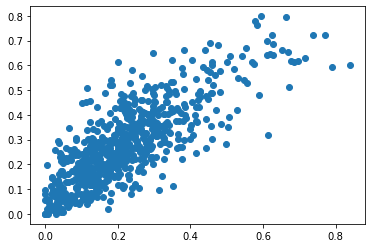

In [73]:
plt.scatter(sixth_compiled['PPUBAS16_20'], sixth_compiled['PFAMINCLT40K16_20'])

# Calculate the correlation
correlation_1 = sixth_compiled['PPUBAS16_20'].corr(sixth_compiled['PFAMINCLT40K16_20'])

# Printing the formatted string with the correlation value
print("The correlation between SNAP benefit proportion and people having less than 40K income is {:.2f}".format(correlation_1))


## Experiment 1: Deriving Food Index for each neighborhood

### Calculating Food Index based on Poverty, # of Supermarkets, # of Fast Food Restaurants and # of Coffee Shops

### a) Normalizing Poverty Rate, # of Supermarkets, # of Fast Food Restaurants, # of Coffee Shops

In [74]:
# Normalize the variables
sixth_compiled['num_supermarkets_norm'] = (sixth_compiled['count_445110'] - sixth_compiled['count_445110'].min()) / (sixth_compiled['count_445110'].max() - sixth_compiled['count_445110'].min())
sixth_compiled['num_fast_food_norm'] = (sixth_compiled['count_722513'] - sixth_compiled['count_722513'].min()) / (sixth_compiled['count_722513'].max() - sixth_compiled['count_722513'].min())
sixth_compiled['num_coffee_shops_norm'] = (sixth_compiled['count_722515'] - sixth_compiled['count_722515'].min()) / (sixth_compiled['count_722515'].max() - sixth_compiled['count_722515'].min())
sixth_compiled['poverty_rate_norm'] = (sixth_compiled['PovertyRate'] - sixth_compiled['PovertyRate'].min()) / (sixth_compiled['PovertyRate'].max() - sixth_compiled['PovertyRate'].min())

### b)  Applying weights to Food Outlets

In [75]:
# Weights for food-related variables
w_S = 0.5  ### Weights for Supermarkets
w_F = 0.3  ### Weight for Fast Food Restaurant
w_C = 0.2  ### Weight for Coffee Shops

# Calculate the Food Environment Score
sixth_compiled['food_env_score'] = (w_S * sixth_compiled['num_supermarkets_norm'] +
                        w_F * (1 - sixth_compiled['num_fast_food_norm']) +
                        w_C * sixth_compiled['num_coffee_shops_norm'])

### c) Calculating Food Index for each Neighborhood

In [76]:
# Calculate the final Food Index

alpha = 0.3  ### Penalizing Neighborhoods having Low Poverty Rates

sixth_compiled['food_index'] = sixth_compiled['food_env_score'] - alpha * sixth_compiled['poverty_rate_norm']

In [77]:
sixth_compiled.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,aden_sales_452319,aden_emp_452319,State_Code,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,15.0377,15.0377,36,047,0.411765,0.125,0.142857,0.308571,0.496954,0.404382
1,36,047,058900,1400000US36047058900,36047058900,589,CT,424025,38353,"POLYGON ((-73.94605 40.72926, -73.94419 40.729...",...,0.0000,0.0000,36,047,0.117647,0.125,0.000000,0.090000,0.321324,0.294324


In [78]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=sixth_compiled.geometry.__geo_interface__,
                                   locations=sixth_compiled.index,
                                   z=sixth_compiled['food_index'],
                                   colorscale='purples_r',
                                   zmin=sixth_compiled['food_index'].min(),
                                   zmax=sixth_compiled['food_index'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in sixth_compiled.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>Food Index: {round(row['food_index']*100, 2)}<br>Median Family Income: {row['MedianFamilyIncome']}<br>Poverty Rate: {row['PovertyRate']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": sixth_compiled.geometry.centroid.y.mean(), 
                                 "lon": sixth_compiled.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title= 'Food Index')
fig.show()


The correlation between SNAP benefit proportion and Food Index is -0.37


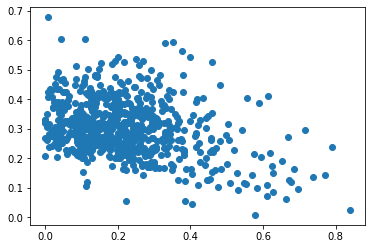

In [79]:
plt.scatter(sixth_compiled['PPUBAS16_20'], sixth_compiled['food_index'])


# Calculate the correlation
correlation_2 = sixth_compiled['PovertyRate'].corr(sixth_compiled['food_index'])

# Printing the formatted string with the correlation value
print("The correlation between SNAP benefit proportion and Food Index is {:.2f}".format(correlation_2))


### Creating subset of final merged dataset

In [80]:
df = sixth_compiled.copy()

In [81]:
df = df.loc[:, ~df.columns.duplicated()]


In [82]:
df['population_y']

0      3478.0
1      1817.0
2      4495.0
3      3829.0
4      3344.0
        ...  
749    3701.0
750    5081.0
751    5281.0
752    4667.0
753    1495.0
Name: population_y, Length: 754, dtype: float64

In [83]:
filtered_df = df[df['population_y'] > 10]

In [84]:
filtered_df.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,aden_sales_452319,aden_emp_452319,State_Code,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,15.0377,15.0377,36,047,0.411765,0.125,0.142857,0.308571,0.496954,0.404382
1,36,047,058900,1400000US36047058900,36047058900,589,CT,424025,38353,"POLYGON ((-73.94605 40.72926, -73.94419 40.729...",...,0.0000,0.0000,36,047,0.117647,0.125,0.000000,0.090000,0.321324,0.294324


In [85]:
filtered_df['population_y'].min()

24.0

In [86]:
df1 = pd.DataFrame()

In [87]:
df1['TRACTCE'] = filtered_df['TRACTCE']
df1['PPUBAS16_20'] = filtered_df['PPUBAS16_20']*100
df1['PFAMINCLT40K16_20'] = filtered_df['PFAMINCLT40K16_20']
df1['PED1_16_20'] = filtered_df['PED1_16_20']
df1['food_index'] = filtered_df['food_index']

In [88]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 750 entries, 0 to 753
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   TRACTCE            750 non-null    object 
 1   PPUBAS16_20        710 non-null    float64
 2   PFAMINCLT40K16_20  710 non-null    float64
 3   PED1_16_20         710 non-null    float64
 4   food_index         750 non-null    float64
dtypes: float64(4), object(1)
memory usage: 35.2+ KB


In [89]:
df1 = df1.dropna()

In [90]:
df1

,TRACTCE,PPUBAS16_20,PFAMINCLT40K16_20,PED1_16_20,food_index
0,057800,27.661511,0.244986,0.174771,0.404382
2,037000,17.842324,0.298548,0.166946,0.291966
3,019900,4.912479,0.105898,0.047463,0.367078
4,040000,22.312373,0.249673,0.237144,0.293307
5,098200,47.532314,0.680469,0.313112,0.102002
...,...,...,...,...,...
749,039700,28.159645,0.367627,0.169576,0.290737
750,010200,21.864952,0.321698,0.455768,0.429939
751,082600,25.283018,0.296239,0.115268,0.402863
752,023400,50.966185,0.635769,0.247269,0.116788


In [91]:
df_cluster1 = df1.drop(["TRACTCE"], axis=1)


### K-Means Clustering

For n_clusters=2, the silhouette score is 0.5758164285184515
For n_clusters=3, the silhouette score is 0.5715267764947367
For n_clusters=4, the silhouette score is 0.5663465239562104
For n_clusters=5, the silhouette score is 0.5221213266261849
For n_clusters=6, the silhouette score is 0.570598144058267
For n_clusters=7, the silhouette score is 0.5668311373910969
For n_clusters=8, the silhouette score is 0.5686494017226998


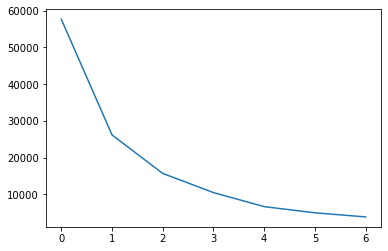

In [92]:

from sklearn.cluster import KMeans

# k-means with some arbitrary k
kmeans = KMeans(n_clusters=4, max_iter=1000)
kmeans.fit(df_cluster1)

kmeans.labels_
# elbow-curve/SSD
ssd = []
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(df_cluster1)
    
    ssd.append(kmeans.inertia_)
    
# plot the SSDs for each n_clusters
# ssd
plt.plot(ssd)

# silhouette analysis
from sklearn.metrics import silhouette_score

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(df_cluster1)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(df_cluster1, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

In [93]:
# k-means with some arbitrary k
kmeans = KMeans(n_clusters=6, max_iter=500)
kmeans.fit(df1)
kmeans.labels_

array([2, 1, 1, 2, 0, 0, 4, 1, 1, 2, 2, 3, 5, 3, 2, 2, 3, 2, 2, 2, 3, 0,
       0, 0, 1, 2, 3, 2, 1, 4, 1, 3, 1, 1, 5, 1, 2, 2, 1, 3, 3, 4, 4, 1,
       4, 2, 1, 3, 2, 2, 1, 1, 4, 1, 2, 3, 4, 0, 3, 1, 1, 2, 3, 1, 5, 0,
       5, 3, 2, 0, 0, 2, 4, 1, 1, 1, 4, 4, 2, 5, 2, 3, 2, 1, 5, 2, 0, 2,
       2, 4, 1, 3, 0, 1, 1, 1, 2, 2, 2, 1, 2, 3, 1, 0, 4, 1, 2, 5, 5, 3,
       3, 3, 1, 1, 2, 0, 3, 1, 1, 1, 1, 3, 2, 1, 4, 3, 3, 3, 0, 0, 0, 0,
       1, 1, 1, 2, 2, 3, 1, 3, 3, 5, 1, 5, 3, 1, 2, 2, 2, 4, 1, 4, 4, 5,
       2, 2, 4, 1, 1, 1, 2, 3, 1, 4, 2, 3, 1, 5, 3, 1, 4, 3, 1, 4, 1, 1,
       2, 1, 2, 2, 2, 4, 3, 1, 2, 5, 0, 3, 2, 2, 5, 0, 1, 2, 4, 4, 4, 4,
       1, 4, 1, 1, 1, 4, 4, 2, 1, 1, 2, 2, 2, 3, 3, 0, 0, 2, 5, 5, 1, 5,
       1, 1, 3, 0, 1, 4, 2, 4, 4, 4, 3, 2, 1, 0, 0, 1, 1, 2, 2, 2, 2, 1,
       3, 2, 2, 3, 2, 2, 1, 1, 5, 3, 3, 2, 2, 4, 3, 0, 3, 1, 1, 5, 2, 3,
       3, 3, 0, 1, 0, 2, 2, 5, 2, 5, 5, 5, 3, 4, 4, 1, 3, 0, 1, 2, 1, 2,
       2, 3, 4, 3, 0, 2, 3, 0, 1, 4, 2, 2, 4, 2, 3,

In [94]:
# assign the label
df1['KMeans Clusters (6 Clusters)'] = kmeans.labels_
df1.head()

,TRACTCE,PPUBAS16_20,PFAMINCLT40K16_20,PED1_16_20,food_index,KMeans Clusters (6 Clusters)
0,057800,27.661511,0.244986,0.174771,0.404382,2
2,037000,17.842324,0.298548,0.166946,0.291966,1
3,019900,4.912479,0.105898,0.047463,0.367078,1
4,040000,22.312373,0.249673,0.237144,0.293307,2
5,098200,47.532314,0.680469,0.313112,0.102002,0


In [95]:
sixth_compiled['clusters'] = df1['KMeans Clusters (6 Clusters)']

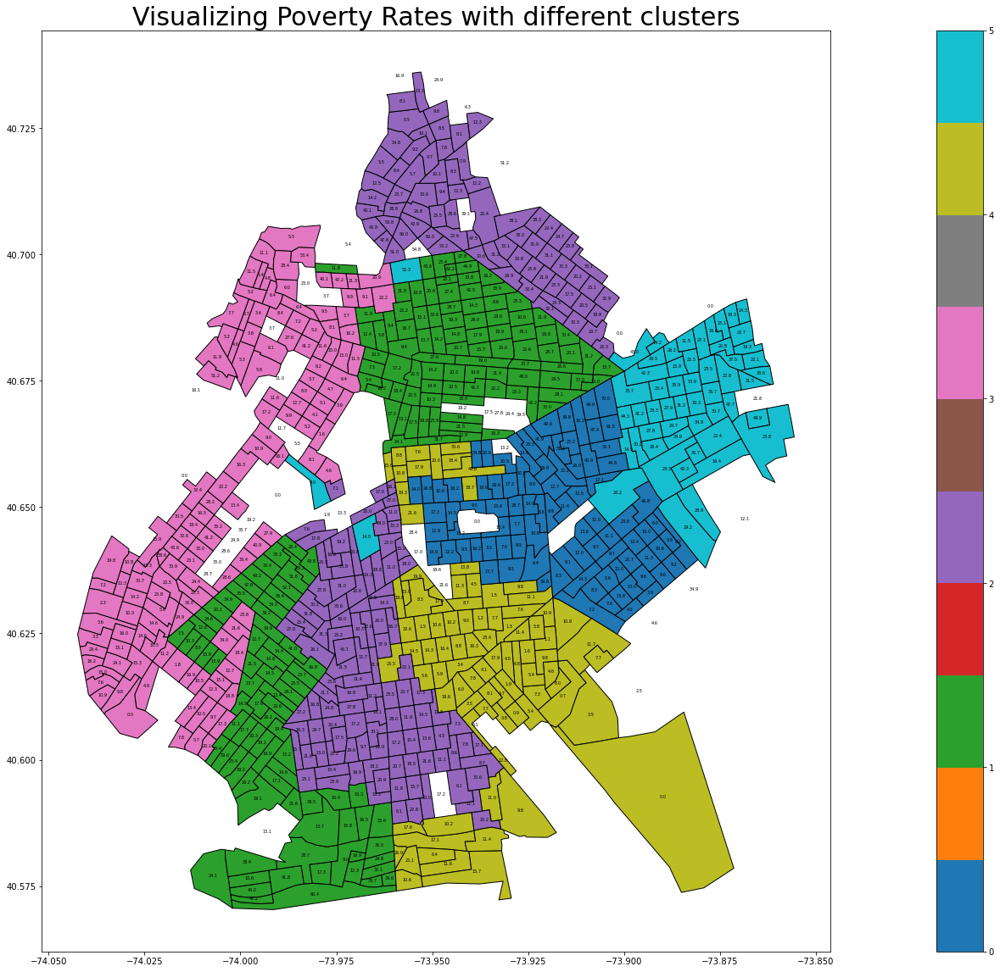

In [96]:
#### Car Sales vs. Primary Sector - 2022

ax = sixth_compiled.plot(column='clusters', cmap='tab10', legend=True, edgecolor='black', figsize=(45,20))
ax.set_title('Visualizing Poverty Rates with different clusters', fontsize=30)

for idx, row in sixth_compiled.iterrows():
    ax.annotate(text=row['PovertyRate'], xy=row['geometry'].centroid.coords[0], ha='center', fontsize='5')
# Create a legend using a scatter plot
plt.show()

### Inferences:

1. The clusters seems to show spatial autocorrelation but with poor Silhouette Scores
2. It is somewhat capturing the extreme food desert areas but not entirely

### DB Scan

In [97]:
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

In [98]:
neigh = NearestNeighbors(n_neighbors=8)
nbrs = neigh.fit(df_cluster1)
distances, indices = nbrs.kneighbors(df_cluster1)

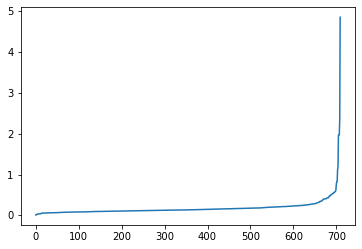

In [99]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [100]:
### Based on above chart, we will choose eps = 1

In [101]:
# Create DBSCAN object
dbscan = DBSCAN(eps=1, min_samples=5)

# Fit the data
dbscan.fit(df_cluster1)

# Obtain the labels
labels = dbscan.labels_

print(labels)


[ 0  0  0  0  1  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  1  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0
  0  0  0  1  0  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  1  0  1  0  0
  0  0  0 -1  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  1  0  0
  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  2  0  1  0  0  0  0
  0  0 -1  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0 -1
  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0 -1  0  1  0  0  1  1  0
  0  3  0  0  0  0  0  0  0  0  1  2  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0 -1  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0

In [102]:
len(labels)

710

In [103]:
df1['db'] = labels

In [104]:
# Merge only the 'Age' column from df2 to df1 based on 'ID'
result_dbscan = pd.merge(sixth_compiled, df1[['TRACTCE', 'db']], on='TRACTCE')

In [105]:
result_dbscan

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,State_Code,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index,clusters,db
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,36,047,0.411765,0.1250,0.142857,0.308571,0.496954,0.404382,2.0,0
1,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588...",...,36,047,0.117647,0.0000,0.000000,0.222857,0.358824,0.291966,1.0,0
2,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686...",...,36,047,0.352941,0.1875,0.000000,0.177143,0.420221,0.367078,1.0,0
3,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598...",...,36,047,0.176471,0.1250,0.000000,0.191429,0.350735,0.293307,2.0,0
4,36,047,098200,1400000US36047098200,36047098200,982,CT,345646,0,"POLYGON ((-73.89794 40.65051, -73.89586 40.651...",...,36,047,0.117647,0.1875,0.000000,0.668571,0.302574,0.102002,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
705,36,047,039700,1400000US36047039700,36047039700,397,CT,159158,0,"POLYGON ((-73.92439 40.69083, -73.92364 40.690...",...,36,047,0.294118,0.0625,0.000000,0.458571,0.428309,0.290737,2.0,0
706,36,047,010200,1400000US36047010200,36047010200,102,CT,152450,0,"POLYGON ((-74.01556 40.64007, -74.01498 40.640...",...,36,047,0.588235,0.3125,0.142857,0.330000,0.528939,0.429939,3.0,0
707,36,047,082600,1400000US36047082600,36047082600,826,CT,199092,0,"POLYGON ((-73.95205 40.64677, -73.94915 40.646...",...,36,047,0.352941,0.0625,0.000000,0.182857,0.457721,0.402863,0.0,0
708,36,047,023400,1400000US36047023400,36047023400,234,CT,169784,0,"POLYGON ((-73.99154 40.63558, -73.99096 40.636...",...,36,047,0.117647,0.0625,0.000000,0.744286,0.340074,0.116788,1.0,3


In [106]:
from geopandas import GeoDataFrame
merged = GeoDataFrame(result_dbscan)

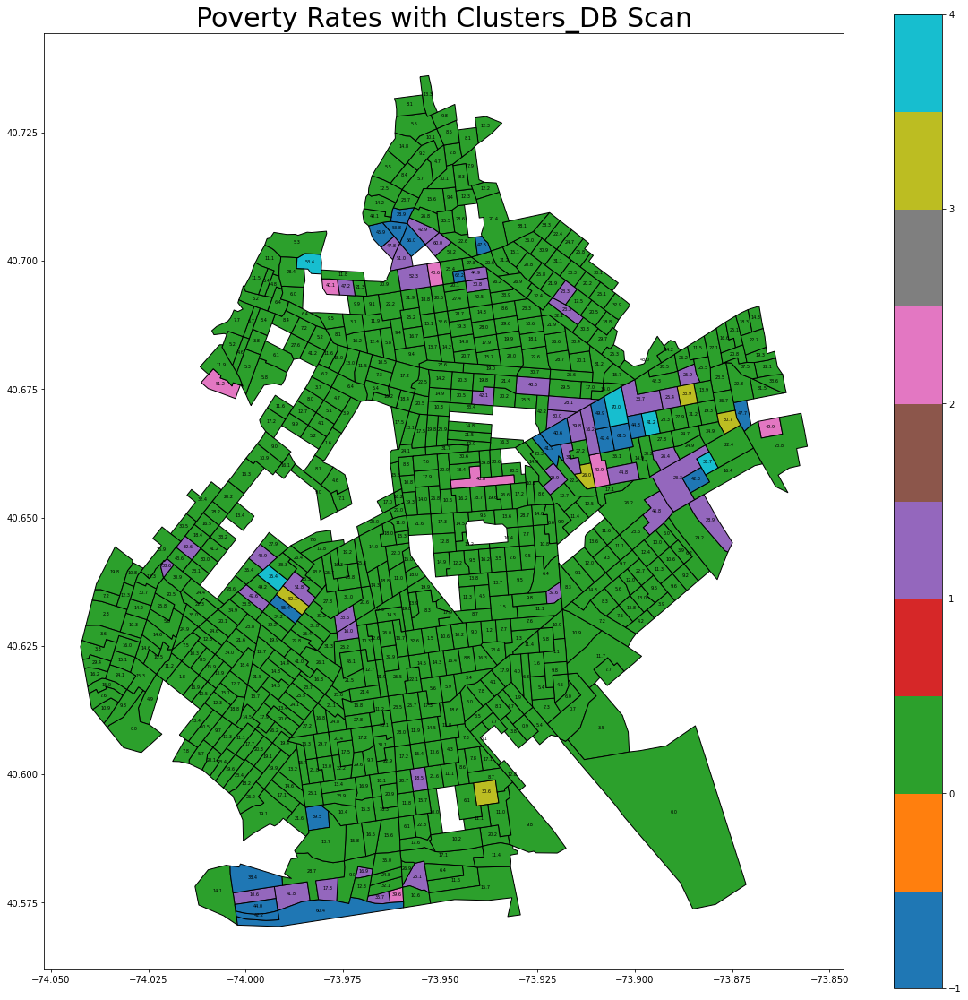

In [107]:
import matplotlib.pyplot as plt

# Assuming 'result' is a GeoDataFrame
fig, ax = plt.subplots(figsize=(20,20))
merged.plot(ax=ax, column='db', cmap='tab10', legend=True, edgecolor='black')
ax.set_title('Poverty Rates with Clusters_DB Scan', fontsize=30)

for idx, row in merged.iterrows():
    if row['geometry'] is not None and row['geometry'].is_valid:
        ax.annotate(text=row['PovertyRate'], xy=row['geometry'].centroid.coords[0], ha='center', fontsize=5)

# Show the plot
plt.show()


In [108]:
fig = go.Figure()

# Adding choropleth map
fig.add_trace(go.Choroplethmapbox(geojson=merged.geometry.__geo_interface__,
                                   locations=merged.index,
                                   z=merged['food_index'],
                                   colorscale='purples_r',
                                   zmin=merged['food_index'].min(),
                                   zmax=merged['food_index'].max(),
                                   marker_opacity=0.5,
                                   marker_line_width=0))
# Adding Hover Over Text
hover_text = []
for idx, row in merged.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>Food Index: {round(row['food_index']*100, 2)}<br>Median Family Income: {row['MedianFamilyIncome']}<br>Poverty Rate: {row['PovertyRate']}<br>SNAP Benefits (%): {round(row['PPUBAS16_20']*100, 2)}<br>Clusters: {row['db']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": merged.geometry.centroid.y.mean(), 
                                 "lon": merged.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title= 'Food Index')
fig.show()


## Insights derived from DB Scan Clusters

1. The Food Index corresponds with SNAP Benefits, Poverty Rates, Median Income, Education and People earning less than 40 K a year

# Next Steps

### 1. Identifying the policies implemented since 2009 and using sliders to see if the Food Index changes over time

### 2. We need to have Poverty Rates at Census Tract Levels from 2009 to 2024

### 3. Aid in recommending new policies based on changing/updating the variables 

In [109]:
# Using apply with a function
def db_labels(score):
    if score == 0:
        return 'Not a LILA zone'
    else:
        return 'LILA Zone'
result_dbscan['labels_apply'] = result_dbscan['db'].apply(db_labels)

In [110]:
result_dbscan['labels_apply']

0      Not a LILA zone
1      Not a LILA zone
2      Not a LILA zone
3      Not a LILA zone
4            LILA Zone
            ...       
705    Not a LILA zone
706    Not a LILA zone
707    Not a LILA zone
708          LILA Zone
709    Not a LILA zone
Name: labels_apply, Length: 710, dtype: object

In [111]:
result_dbscan['labels_apply'].value_counts()

Not a LILA zone    632
LILA Zone           78
Name: labels_apply, dtype: int64

In [112]:
(78/632)*100

12.341772151898734

In [113]:
result_dbscan

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index,clusters,db,labels_apply
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,047,0.411765,0.1250,0.142857,0.308571,0.496954,0.404382,2.0,0,Not a LILA zone
1,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588...",...,047,0.117647,0.0000,0.000000,0.222857,0.358824,0.291966,1.0,0,Not a LILA zone
2,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686...",...,047,0.352941,0.1875,0.000000,0.177143,0.420221,0.367078,1.0,0,Not a LILA zone
3,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598...",...,047,0.176471,0.1250,0.000000,0.191429,0.350735,0.293307,2.0,0,Not a LILA zone
4,36,047,098200,1400000US36047098200,36047098200,982,CT,345646,0,"POLYGON ((-73.89794 40.65051, -73.89586 40.651...",...,047,0.117647,0.1875,0.000000,0.668571,0.302574,0.102002,0.0,1,LILA Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
705,36,047,039700,1400000US36047039700,36047039700,397,CT,159158,0,"POLYGON ((-73.92439 40.69083, -73.92364 40.690...",...,047,0.294118,0.0625,0.000000,0.458571,0.428309,0.290737,2.0,0,Not a LILA zone
706,36,047,010200,1400000US36047010200,36047010200,102,CT,152450,0,"POLYGON ((-74.01556 40.64007, -74.01498 40.640...",...,047,0.588235,0.3125,0.142857,0.330000,0.528939,0.429939,3.0,0,Not a LILA zone
707,36,047,082600,1400000US36047082600,36047082600,826,CT,199092,0,"POLYGON ((-73.95205 40.64677, -73.94915 40.646...",...,047,0.352941,0.0625,0.000000,0.182857,0.457721,0.402863,0.0,0,Not a LILA zone
708,36,047,023400,1400000US36047023400,36047023400,234,CT,169784,0,"POLYGON ((-73.99154 40.63558, -73.99096 40.636...",...,047,0.117647,0.0625,0.000000,0.744286,0.340074,0.116788,1.0,3,LILA Zone


In [114]:
import plotly.graph_objects as go

# Adding choropleth map
fig = go.Figure()

# Adding the base map layer with different colors based on food desert status
fig.add_trace(go.Choroplethmapbox(geojson=result_dbscan.geometry.__geo_interface__,
                                  locations=result_dbscan.index,
                                  z=result_dbscan['labels_apply'].apply(lambda x: 1 if x == 'LILA Zone' else 0),
                                  colorscale=[[0, 'rgba(0,0,0,0)'], [1, 'red']],
                                  showscale=False,
                                  marker_opacity=0.5,
                                  marker_line_width=0))

# Adding Hover Over Text
hover_text = []
for idx, row in result_dbscan.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE']}<br>Food Index: {round(row['food_index']*100, 2)}<br>Median Family Income: {row['MedianFamilyIncome']}<br>Poverty Rate: {row['PovertyRate']}<br>SNAP Benefits (%): {round(row['PPUBAS16_20']*100, 2)}<br>Clusters: {row['db']}<br>Status: {row['labels_apply']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": merged.geometry.centroid.y.mean(), 
                                 "lon": merged.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title= 'Food Index')
fig.show()


In [115]:
df_db = pd.DataFrame()

In [116]:
df_db['Census Tract'] = result_dbscan['TRACTCE']

In [117]:
df_db['Status'] = result_dbscan['labels_apply']

In [118]:
census = df_db[df_db['Status']  == 'Food Desert']

In [119]:
census_l = census.values.tolist()

In [120]:
census_l

[]

In [121]:
import plotly.graph_objs as go
import plotly.offline as pyo

In [122]:
pyo.plot(fig, filename='LILA_map.html')

'LILA_map.html'

In [123]:
result_dbscan.head()

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index,clusters,db,labels_apply
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,047,0.411765,0.1250,0.142857,0.308571,0.496954,0.404382,2.0,0,Not a LILA zone
1,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588...",...,047,0.117647,0.0000,0.000000,0.222857,0.358824,0.291966,1.0,0,Not a LILA zone
2,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686...",...,047,0.352941,0.1875,0.000000,0.177143,0.420221,0.367078,1.0,0,Not a LILA zone
3,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598...",...,047,0.176471,0.1250,0.000000,0.191429,0.350735,0.293307,2.0,0,Not a LILA zone
4,36,047,098200,1400000US36047098200,36047098200,982,CT,345646,0,"POLYGON ((-73.89794 40.65051, -73.89586 40.651...",...,047,0.117647,0.1875,0.000000,0.668571,0.302574,0.102002,0.0,1,LILA Zone


In [124]:
df3 = pd.read_csv('NTA.csv')
df3.head(2)

,GEOID,CountyFIPS,BoroCode,BoroName,BoroCT2020,CT2020,CTLabel,NTACode,NTAType,NTAName,NTAAbbrev,CDTACode,CDTAType,CDTAName
0,36005001901,5,2,Bronx,2001901,1901,19.01,BX0101,0,Mott Haven-Port Morris,MttHvn,BX01,CD,BX01 Melrose-Mott Haven-Port Morris (CD 1 Appr...
1,36005001902,5,2,Bronx,2001902,1902,19.02,BX0101,0,Mott Haven-Port Morris,MttHvn,BX01,CD,BX01 Melrose-Mott Haven-Port Morris (CD 1 Appr...


In [125]:
# Extract the last 6 digits and create a new column 'TRACTCE'
df3['TRACTCE'] = df['GEOID'].astype(str).str[-6:]

In [126]:
df4 = df3[df3['BoroName']=='Brooklyn']

In [127]:
df4['NTAName'].nunique()

69

In [128]:
df4

,GEOID,CountyFIPS,BoroCode,BoroName,BoroCT2020,CT2020,CTLabel,NTACode,NTAType,NTAName,NTAAbbrev,CDTACode,CDTAType,CDTAName,TRACTCE
361,36047049900,47,3,Brooklyn,3049900,49900,499.00,BK0101,0,Greenpoint,Grnpt,BK01,CD,BK01 Williamsburg-Greenpoint (CD 1 Equivalent),068000
362,36047056100,47,3,Brooklyn,3056100,56100,561.00,BK0101,0,Greenpoint,Grnpt,BK01,CD,BK01 Williamsburg-Greenpoint (CD 1 Equivalent),002901
363,36047056301,47,3,Brooklyn,3056301,56301,563.01,BK0101,0,Greenpoint,Grnpt,BK01,CD,BK01 Williamsburg-Greenpoint (CD 1 Equivalent),016800
364,36047056302,47,3,Brooklyn,3056302,56302,563.02,BK0101,0,Greenpoint,Grnpt,BK01,CD,BK01 Williamsburg-Greenpoint (CD 1 Equivalent),038800
365,36047056500,47,3,Brooklyn,3056500,56500,565.00,BK0101,0,Greenpoint,Grnpt,BK01,CD,BK01 Williamsburg-Greenpoint (CD 1 Equivalent),114400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1161,36047103402,47,3,Brooklyn,3103402,103402,1034.02,BK1893,9,Canarsie Park & Pier,CnrsiePk,BK18,CD,BK18 Canarsie-Flatlands (CD 18 Approximation),NaN
1162,36047017700,47,3,Brooklyn,3017700,17700,177.00,BK5591,9,Prospect Park,PrspctPk,BK55,JIA,BK55 Prospect Park (JIA 55 Approximation),NaN
1163,36047070202,47,3,Brooklyn,3070202,70202,702.02,BK5691,9,Barren Island-Floyd Bennett Field,BrrnIsl,BK56,JIA,BK56 Jamaica Bay (West) (JIA 56 Approximation),NaN
1164,36047070203,47,3,Brooklyn,3070203,70203,702.03,BK5692,9,Jamaica Bay (West),JmcaBy_W,BK56,JIA,BK56 Jamaica Bay (West) (JIA 56 Approximation),NaN


In [129]:
result_dbscan['GEOID'].dtype

dtype('O')

In [130]:
result_dbscan['GEOID'] = result_dbscan['GEOID'].astype('int64')


In [131]:
result_dbscan['GEOID'].dtype

dtype('int64')

In [132]:
result_dbscan

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,County_Code,num_supermarkets_norm,num_fast_food_norm,num_coffee_shops_norm,poverty_rate_norm,food_env_score,food_index,clusters,db,labels_apply
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,047,0.411765,0.1250,0.142857,0.308571,0.496954,0.404382,2.0,0,Not a LILA zone
1,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588...",...,047,0.117647,0.0000,0.000000,0.222857,0.358824,0.291966,1.0,0,Not a LILA zone
2,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686...",...,047,0.352941,0.1875,0.000000,0.177143,0.420221,0.367078,1.0,0,Not a LILA zone
3,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598...",...,047,0.176471,0.1250,0.000000,0.191429,0.350735,0.293307,2.0,0,Not a LILA zone
4,36,047,098200,1400000US36047098200,36047098200,982,CT,345646,0,"POLYGON ((-73.89794 40.65051, -73.89586 40.651...",...,047,0.117647,0.1875,0.000000,0.668571,0.302574,0.102002,0.0,1,LILA Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
705,36,047,039700,1400000US36047039700,36047039700,397,CT,159158,0,"POLYGON ((-73.92439 40.69083, -73.92364 40.690...",...,047,0.294118,0.0625,0.000000,0.458571,0.428309,0.290737,2.0,0,Not a LILA zone
706,36,047,010200,1400000US36047010200,36047010200,102,CT,152450,0,"POLYGON ((-74.01556 40.64007, -74.01498 40.640...",...,047,0.588235,0.3125,0.142857,0.330000,0.528939,0.429939,3.0,0,Not a LILA zone
707,36,047,082600,1400000US36047082600,36047082600,826,CT,199092,0,"POLYGON ((-73.95205 40.64677, -73.94915 40.646...",...,047,0.352941,0.0625,0.000000,0.182857,0.457721,0.402863,0.0,0,Not a LILA zone
708,36,047,023400,1400000US36047023400,36047023400,234,CT,169784,0,"POLYGON ((-73.99154 40.63558, -73.99096 40.636...",...,047,0.117647,0.0625,0.000000,0.744286,0.340074,0.116788,1.0,3,LILA Zone


In [133]:
final = pd.merge(result_dbscan, df4, on='GEOID', how='left')
final

,STATEFP,COUNTYFP,TRACTCE_x,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,...,CT2020,CTLabel,NTACode,NTAType,NTAName,NTAAbbrev,CDTACode,CDTAType,CDTAName,TRACTCE_y
0,36,047,057800,1400000US36047057800,36047057800,578,CT,172233,0,"POLYGON ((-73.95398 40.60140, -73.95304 40.601...",...,57800,578.0,BK1502,0,Madison,Mdsn,BK15,CD,BK15 Sheepshead Bay-Gravesend (East) (CD 15 Ap...,NaN
1,36,047,037000,1400000US36047037000,36047037000,370,CT,336242,0,"POLYGON ((-73.96615 40.58667, -73.96564 40.588...",...,37000,370.0,BK1301,0,Gravesend (South),Grvsnd_S,BK13,CD,BK13 Coney Island-Brighton Beach (CD 13 Approx...,NaN
2,36,047,019900,1400000US36047019900,36047019900,199,CT,188914,0,"POLYGON ((-73.96949 40.68629, -73.96749 40.686...",...,19900,199.0,BK0204,0,Clinton Hill,ClntnHl,BK02,CD,BK02 Downtown Brooklyn-Fort Greene (CD 2 Appro...,096600
3,36,047,040000,1400000US36047040000,36047040000,400,CT,192000,0,"POLYGON ((-73.98078 40.59845, -73.97986 40.598...",...,40000,400.0,BK1103,0,Gravesend (West),Grvsnd_W,BK11,CD,BK11 Bensonhurst-Bath Beach (CD 11 Approximation),NaN
4,36,047,098200,1400000US36047098200,36047098200,982,CT,345646,0,"POLYGON ((-73.89794 40.65051, -73.89586 40.651...",...,98200,982.0,BK1803,0,Canarsie,Cnrsie,BK18,CD,BK18 Canarsie-Flatlands (CD 18 Approximation),NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
705,36,047,039700,1400000US36047039700,36047039700,397,CT,159158,0,"POLYGON ((-73.92439 40.69083, -73.92364 40.690...",...,39700,397.0,BK0402,0,Bushwick (East),Bshwck_E,BK04,CD,BK04 Bushwick (CD 4 Equivalent),080600
706,36,047,010200,1400000US36047010200,36047010200,102,CT,152450,0,"POLYGON ((-74.01556 40.64007, -74.01498 40.640...",...,10200,102.0,BK0703,0,Sunset Park (Central),SnstPk_C,BK07,CD,BK07 Sunset Park-Windsor Terrace (CD 7 Approxi...,122000
707,36,047,082600,1400000US36047082600,36047082600,826,CT,199092,0,"POLYGON ((-73.95205 40.64677, -73.94915 40.646...",...,82600,826.0,BK1701,0,East Flatbush-Erasmus,EFb_Ersms,BK17,CD,BK17 East Flatbush (CD 17 Approximation),NaN
708,36,047,023400,1400000US36047023400,36047023400,234,CT,169784,0,"POLYGON ((-73.99154 40.63558, -73.99096 40.636...",...,23400,234.0,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN


In [134]:
l = list(final.columns)

In [135]:
l

['STATEFP',
 'COUNTYFP',
 'TRACTCE_x',
 'AFFGEOID',
 'GEOID',
 'NAME',
 'LSAD',
 'ALAND',
 'AWATER',
 'geometry',
 'CensusTract',
 'State',
 'County',
 'Urban',
 'Pop2010',
 'OHU2010',
 'GroupQuartersFlag',
 'NUMGQTRS',
 'PCTGQTRS',
 'LILATracts_1And10',
 'LILATracts_halfAnd10',
 'LILATracts_1And20',
 'LILATracts_Vehicle',
 'HUNVFlag',
 'LowIncomeTracts',
 'PovertyRate',
 'MedianFamilyIncome',
 'LA1and10',
 'LAhalfand10',
 'LA1and20',
 'LATracts_half',
 'LATracts1',
 'LATracts10',
 'LATracts20',
 'LATractsVehicle_20',
 'LAPOP1_10',
 'LAPOP05_10',
 'LAPOP1_20',
 'LALOWI1_10',
 'LALOWI05_10',
 'LALOWI1_20',
 'lapophalf',
 'lapophalfshare',
 'lalowihalf',
 'lalowihalfshare',
 'lakidshalf',
 'lakidshalfshare',
 'laseniorshalf',
 'laseniorshalfshare',
 'lawhitehalf',
 'lawhitehalfshare',
 'lablackhalf',
 'lablackhalfshare',
 'laasianhalf',
 'laasianhalfshare',
 'lanhopihalf',
 'lanhopihalfshare',
 'laaianhalf',
 'laaianhalfshare',
 'laomultirhalf',
 'laomultirhalfshare',
 'lahisphalf',
 'la

In [136]:
final1 = pd.DataFrame()

In [137]:
final1['TRACTCE'] = final['TRACTCE_x']

In [138]:
final1['Status'] = final['labels_apply']
final1['NTA Name'] = final['NTAName']
final1['Median Family Income'] = final['MedianFamilyIncome']
final1['SNAP Benefits %'] = final['PPUBAS16_20']
final1['Education below high school diploma'] = final['PED1_16_20']
final1['Pop earning <=40K'] = final['PFAMINCLT40K16_20']
final1['Food Index'] = final['food_index']

In [139]:
final1['NTA Name'].unique()

array(['Madison', 'Gravesend (South)', 'Clinton Hill', 'Gravesend (West)',
       'Canarsie', 'East Flatbush-Erasmus',
       'Prospect Lefferts Gardens-Wingate', 'Dyker Heights', 'Ocean Hill',
       'South Williamsburg', 'Park Slope', 'East New York-New Lots',
       'Fort Greene', 'Mapleton-Midwood (West)', 'East Williamsburg',
       'Carroll Gardens-Cobble Hill-Gowanus-Red Hook', 'Brooklyn Heights',
       'Bedford-Stuyvesant (East)', 'Bushwick (East)',
       'Downtown Brooklyn-DUMBO-Boerum Hill',
       'Gravesend (East)-Homecrest', 'Crown Heights (North)', 'Flatlands',
       'Bay Ridge', 'Flatbush (West)-Ditmas Park-Parkville', 'Bath Beach',
       'Bedford-Stuyvesant (West)', 'Marine Park-Mill Basin-Bergen Beach',
       'Borough Park', 'Flatbush', 'Brighton Beach', 'Bensonhurst',
       'Bushwick (West)', 'Cypress Hills', 'East New York (North)',
       'Kensington', 'East Flatbush-Rugby', 'Midwood',
       'Coney Island-Sea Gate', 'Williamsburg', 'Greenpoint',
       'East 

In [140]:
final1[final1['Status'] == "LILA Zone"]

,TRACTCE,Status,NTA Name,Median Family Income,SNAP Benefits %,Education below high school diploma,Pop earning <=40K,Food Index
4,098200,LILA Zone,Canarsie,22055.0,0.475323,0.313112,0.680469,0.102002
9,052900,LILA Zone,South Williamsburg,32250.0,0.458476,0.336395,0.599241,0.351437
28,034300,LILA Zone,Crown Heights (North),29464.0,0.416211,0.196404,0.544920,0.237218
37,048000,LILA Zone,Flatbush (West)-Ditmas Park-Parkville,41667.0,0.443434,0.344775,0.477876,0.335044
51,028300,LILA Zone,Bedford-Stuyvesant (East),36806.0,0.425430,0.240978,0.472385,0.222202
...,...,...,...,...,...,...,...,...
671,111000,LILA Zone,East New York-New Lots,25111.0,0.569666,0.336369,0.614549,0.142714
673,036300,LILA Zone,Ocean Hill,34701.0,0.454124,0.231696,0.574516,0.221378
683,028502,LILA Zone,Bedford-Stuyvesant (East),22813.0,0.420495,0.245517,0.482800,0.107571
691,025500,LILA Zone,Bedford-Stuyvesant (West),23520.0,0.624094,0.441472,0.721664,0.171966


In [141]:
pd.set_option('display.max_rows', None)

In [142]:
final1['TRACTCE'] = final1['TRACTCE'].astype('object')

In [143]:
final1[final1['Status'] == "LILA Zone"]

,TRACTCE,Status,NTA Name,Median Family Income,SNAP Benefits %,Education below high school diploma,Pop earning <=40K,Food Index
4,098200,LILA Zone,Canarsie,22055.0,0.475323,0.313112,0.680469,0.102002
9,052900,LILA Zone,South Williamsburg,32250.0,0.458476,0.336395,0.599241,0.351437
28,034300,LILA Zone,Crown Heights (North),29464.0,0.416211,0.196404,0.544920,0.237218
37,048000,LILA Zone,Flatbush (West)-Ditmas Park-Parkville,41667.0,0.443434,0.344775,0.477876,0.335044
51,028300,LILA Zone,Bedford-Stuyvesant (East),36806.0,0.425430,0.240978,0.472385,0.222202
53,036002,LILA Zone,Brighton Beach,36853.0,0.618280,0.135468,0.644578,0.217681
74,023600,LILA Zone,Borough Park,28375.0,0.542940,0.229691,0.637127,0.295345
88,058000,LILA Zone,Madison,61458.0,0.398618,0.152686,0.344000,0.543403
91,018501,LILA Zone,Fort Greene,26219.0,0.424918,0.253895,0.496054,0.188523
93,035601,LILA Zone,Coney Island-Sea Gate,60000.0,0.458333,0.035789,0.488429,0.227571


In [144]:
df5 = final1[final1['Status'] == "LILA Zone"]
df5.head(2)

,TRACTCE,Status,NTA Name,Median Family Income,SNAP Benefits %,Education below high school diploma,Pop earning <=40K,Food Index
4,098200,LILA Zone,Canarsie,22055.0,0.475323,0.313112,0.680469,0.102002
9,052900,LILA Zone,South Williamsburg,32250.0,0.458476,0.336395,0.599241,0.351437


In [145]:
df5

,TRACTCE,Status,NTA Name,Median Family Income,SNAP Benefits %,Education below high school diploma,Pop earning <=40K,Food Index
4,098200,LILA Zone,Canarsie,22055.0,0.475323,0.313112,0.680469,0.102002
9,052900,LILA Zone,South Williamsburg,32250.0,0.458476,0.336395,0.599241,0.351437
28,034300,LILA Zone,Crown Heights (North),29464.0,0.416211,0.196404,0.544920,0.237218
37,048000,LILA Zone,Flatbush (West)-Ditmas Park-Parkville,41667.0,0.443434,0.344775,0.477876,0.335044
51,028300,LILA Zone,Bedford-Stuyvesant (East),36806.0,0.425430,0.240978,0.472385,0.222202
53,036002,LILA Zone,Brighton Beach,36853.0,0.618280,0.135468,0.644578,0.217681
74,023600,LILA Zone,Borough Park,28375.0,0.542940,0.229691,0.637127,0.295345
88,058000,LILA Zone,Madison,61458.0,0.398618,0.152686,0.344000,0.543403
91,018501,LILA Zone,Fort Greene,26219.0,0.424918,0.253895,0.496054,0.188523
93,035601,LILA Zone,Coney Island-Sea Gate,60000.0,0.458333,0.035789,0.488429,0.227571


In [146]:
df5.to_csv('LILAzones.csv')

In [147]:
import plotly.graph_objects as go

# Adding choropleth map
fig = go.Figure()

# Adding the base map layer with different colors based on food desert status
fig.add_trace(go.Choroplethmapbox(geojson=final.geometry.__geo_interface__,
                                  locations=final.index,
                                  z=final['labels_apply'].apply(lambda x: 1 if x == 'LILA Zone' else 0),
                                  colorscale=[[0, 'rgba(0,0,0,0)'], [1, 'red']],
                                  showscale=False,
                                  marker_opacity=0.5,
                                  marker_line_width=0))

# Adding Hover Over Text
hover_text = []
for idx, row in final.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE_x']}<br>NTA: {row['NTAName']}<br>Food Index: {round(row['food_index']*100, 2)}<br>Median Family Income: {row['MedianFamilyIncome']}<br>Poverty Rate: {row['PovertyRate']}<br>SNAP Benefits (%): {round(row['PPUBAS16_20']*100, 2)}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": merged.geometry.centroid.y.mean(), 
                                 "lon": merged.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title= 'Food Index')
fig.show()


In [148]:
pyo.plot(fig, filename='LILA_map1.html')

'LILA_map1.html'

In [149]:
import plotly.graph_objects as go
import plotly.express as px

# Filter data for 'LILA Zone'
filtered_data = final[final['labels_apply'] == 'LILA Zone']

# Create a color mapping for different NTAName values using Plotly's qualitative colors
unique_nta_names = filtered_data['NTAName'].unique()
colors = px.colors.qualitative.Plotly  # You can choose other color sequences from px.colors.qualitative
color_scale = {nta: colors[i % len(colors)] for i, nta in enumerate(unique_nta_names)}

# Adding choropleth map
fig = go.Figure()

# Adding the base map layer with different colors based on NTAName for 'LILA Zone'
fig.add_trace(go.Choroplethmapbox(geojson=filtered_data.geometry.__geo_interface__,
                                  locations=filtered_data.index,
                                  z=filtered_data['NTAName'].map(color_scale),
                                  colorscale=[[i / (len(colors) - 1), colors[i % len(colors)]] for i in range(len(colors))],
                                  showscale=False,
                                  marker_opacity=0.5,
                                  marker_line_width=0))

# Adding Hover Over Text
hover_text = []
for idx, row in filtered_data.iterrows():
    hover_text.append(
        f"Census Tract Area: {row['TRACTCE_x']}<br>NTA: {row['NTAName']}<br>Food Index: {round(row['food_index']*100, 2)}<br>Median Family Income: {row['MedianFamilyIncome']}<br>Poverty Rate: {row['PovertyRate']}<br>SNAP Benefits (%): {round(row['PPUBAS16_20']*100, 2)}<br>Clusters: {row['db']}<br>Status: {row['labels_apply']}")

fig.update_traces(hoverinfo='text', text=hover_text)

fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=8,
                  mapbox_center={"lat": merged.geometry.centroid.y.mean(), 
                                 "lon": merged.geometry.centroid.x.mean()},
                  margin={"r":0,"t":0,"l":0,"b":0},
                  hovermode='closest',
                  title='Food Index')
fig.show()


In [150]:
df6 = pd.read_csv('LILAZones_v3.csv')
df6.head(2)

,S.No,TRACTCE,Status,NTA Name,Med Fam Income,Rank - Med Fam Income (Worst to Best),SNAP Benefits %,Rank (SNAP %) - High to Low,Education below high school diploma,Rank - Education (Low to High),Pop earning <=40K,Rank - Pop earning <=40K,Food Index,Rank - Food Index
0,1,28300,LILA Zone,Bedford-Stuyvesant (East),36806,46,42.5%,62,24.1%,35,47.2%,25,22.2%,43
1,2,28502,LILA Zone,Bedford-Stuyvesant (East),22813,9,42.0%,65,24.6%,37,48.3%,28,10.8%,11


In [151]:
df6['TRACTCE'] = df6['TRACTCE'].astype(str)

df6['TRACTCE'] = df6['TRACTCE'].str.zfill(6)

In [152]:
df6 = df6.rename(columns={'TRACTCE': 'TRACTCE_x'})


In [153]:
df7 = pd.merge(df6, final, on='TRACTCE_x', how='left')


In [154]:
df7

,S.No,TRACTCE_x,Status,NTA Name,Med Fam Income,Rank - Med Fam Income (Worst to Best),SNAP Benefits %,Rank (SNAP %) - High to Low,Education below high school diploma,Rank - Education (Low to High),...,CT2020,CTLabel,NTACode,NTAType,NTAName,NTAAbbrev,CDTACode,CDTAType,CDTAName,TRACTCE_y
0,1,028300,LILA Zone,Bedford-Stuyvesant (East),36806,46,42.5%,62,24.1%,35,...,28300,283.00,BK0302,0,Bedford-Stuyvesant (East),BdSty_E,BK03,CD,BK03 Bedford-Stuyvesant (CD 3 Approximation),012200
1,2,028502,LILA Zone,Bedford-Stuyvesant (East),22813,9,42.0%,65,24.6%,37,...,28502,285.02,BK0302,0,Bedford-Stuyvesant (East),BdSty_E,BK03,CD,BK03 Bedford-Stuyvesant (CD 3 Approximation),049000
2,3,025902,LILA Zone,Bedford-Stuyvesant (West),22599,8,66.5%,11,37.9%,71,...,25902,259.02,BK0301,0,Bedford-Stuyvesant (West),BdSty_W,BK03,CD,BK03 Bedford-Stuyvesant (CD 3 Approximation),038200
3,4,123700,LILA Zone,Bedford-Stuyvesant (West),32545,38,48.2%,39,31.2%,55,...,123700,1237.00,BK0301,0,Bedford-Stuyvesant (West),BdSty_W,BK03,CD,BK03 Bedford-Stuyvesant (CD 3 Approximation),077200
4,5,025500,LILA Zone,Bedford-Stuyvesant (West),23520,11,62.4%,15,44.1%,77,...,25500,255.00,BK0301,0,Bedford-Stuyvesant (West),BdSty_W,BK03,CD,BK03 Bedford-Stuyvesant (CD 3 Approximation),085400
5,6,023600,LILA Zone,Borough Park,28375,26,54.3%,29,23.0%,29,...,23600,236.00,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN
6,7,021800,LILA Zone,Borough Park,30732,30,41.6%,69,22.4%,25,...,21800,218.00,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN
7,8,022200,LILA Zone,Borough Park,40455,55,58.8%,21,20.5%,22,...,22200,222.00,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN
8,9,023200,LILA Zone,Borough Park,46484,63,44.9%,53,23.2%,31,...,23200,232.00,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN
9,10,023400,LILA Zone,Borough Park,31800,35,51.0%,33,24.7%,38,...,23400,234.00,BK1202,0,Borough Park,BoroPk,BK12,CD,BK12 Borough Park-Kensington (CD 12 Approximat...,NaN
